In [1]:
!pip freeze > ../requirements.txt

The process cannot access the file because it is being used by another process.


In [2]:
import os
import sys
sys.path.append(r'..')

import pandas as pd
from scripts.data_analysis import *
from scripts.visualization import *
from scripts.financial_analysis import *
from scripts.data_transformation import *

c:\Users\Darkles\10academy\10Academy-Kifiya-Week-1\env\Lib\site-packages\pyfolio\pos.py:25: UserWarning: Module "zipline.assets" not found; multipliers will not be applied to position notionals.
  warnings.warn(
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [3]:
datasets_folder = r"../datasets/raw/yfinance_data"
dataset_name = "GOOG_historical_data.csv"
dataset_path = os.path.join(datasets_folder, dataset_name)

df_GOOG = load_data(dataset_path)
# df_GOOG['Date'] = pd.to_datetime(df_GOOG['Date'])
df = clean_stock_data(df_GOOG)
# df, _ = clean_and_preprocess_data(df, date_column="Date")
df

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits
Date,,,,,,,,,
2004-08-19,2004-08-19,2.490664,2.591785,2.390042,2.499133,2.496292,897427216,0.0,0.0
2004-08-20,2004-08-20,2.515820,2.716817,2.503118,2.697639,2.694573,458857488,0.0,0.0
2004-08-23,2004-08-23,2.758411,2.826406,2.716070,2.724787,2.721690,366857939,0.0,0.0
2004-08-24,2004-08-24,2.770615,2.779581,2.579581,2.611960,2.608991,306396159,0.0,0.0
2004-08-25,2004-08-25,2.614201,2.689918,2.587302,2.640104,2.637103,184645512,0.0,0.0
...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,175.389999,177.949997,173.570007,174.369995,174.369995,31250700,0.0,0.0
2024-07-25,2024-07-25,174.250000,175.199997,169.050003,169.160004,169.160004,28967900,0.0,0.0
2024-07-26,2024-07-26,168.770004,169.839996,165.865005,168.679993,168.679993,25150100,0.0,0.0


In [4]:
# Summarize the data
summary = summarize_data(df)

# Print the summary in a more presentable format
print("Dataset Summary:")
print(f"Shape: {summary['shape']}")
print("\nMissing Values:")
for column, missing in summary['missing_values'].items():
    print(f"{column}: {missing}")

print("\nDuplicates:")
print(summary['duplicates'])

print("\nUnique Values:")
for column, unique in summary['unique_values'].items():
    print(f"{column}: {unique}")

print("\nColumn Statistics:")
for column, stats in summary['column_stats'].items():
    print(f"\n{column}:")
    for stat, value in stats.items():
        print(f"  {stat}: {value}")

Dataset Summary:
Shape: (5020, 9)

Missing Values:
Date: 0
Open: 0
High: 0
Low: 0
Close: 0
Adj Close: 0
Volume: 0
Dividends: 0
Stock Splits: 0

Duplicates:
0

Unique Values:
Date: 5020
Open: 4865
High: 4869
Low: 4904
Close: 4923
Adj Close: 4923
Volume: 4907
Dividends: 2
Stock Splits: 4

Column Statistics:

Date:
  count: 5020
  mean: 2014-08-07 16:36:31.553784832
  min: 2004-08-19 00:00:00
  25%: 2009-08-12 18:00:00
  50%: 2014-08-07 12:00:00
  75%: 2019-08-02 18:00:00
  max: 2024-07-30 00:00:00
  std: nan

Open:
  count: 5020.0
  mean: 45.2513154273964
  min: 2.470489978790283
  25%: 13.034704685211182
  50%: 26.982210159301758
  75%: 60.215126037597656
  max: 191.75
  std: 43.33863516599722

High:
  count: 5020.0
  mean: 45.7287927790467
  min: 2.5340020656585693
  25%: 13.145415306091309
  50%: 27.194902420043945
  75%: 60.75837516784668
  max: 193.30999755859372
  std: 43.818297790395775

Low:
  count: 5020.0
  mean: 44.80058707212547
  min: 2.3900420665740967
  25%: 12.88159155845

In [5]:
indicators = calculate_technical_indicators(df)
multi_value__indicators = calculate_multi_value_indicators(df)
indicators.update(multi_value__indicators)

# [df.__setitem__(indicator, values) for indicator, values in indicators.items()]
for indicator, values in indicators.items():
    df[indicator] = values
df

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,MACD_Hist,WMA,BB_upper,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist
Date,,,,,,,,,,,,,,,,,,,,,
2004-08-19,2004-08-19,2.490664,2.591785,2.390042,2.499133,2.496292,897427216,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-08-20,2004-08-20,2.515820,2.716817,2.503118,2.697639,2.694573,458857488,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-08-23,2004-08-23,2.758411,2.826406,2.716070,2.724787,2.721690,366857939,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-08-24,2004-08-24,2.770615,2.779581,2.579581,2.611960,2.608991,306396159,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-08-25,2004-08-25,2.614201,2.689918,2.587302,2.640104,2.637103,184645512,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,175.389999,177.949997,173.570007,174.369995,174.369995,31250700,0.0,0.0,185.500001,...,-1.605182,184.240477,194.257939,185.500001,176.742062,4.024337,22.104702,-219.030910,-9.493412,-1.605182
2024-07-25,2024-07-25,174.250000,175.199997,169.050003,169.160004,169.160004,28967900,0.0,0.0,184.689501,...,-2.142167,182.684287,195.979743,184.689501,173.399259,4.176170,23.381824,-236.032667,-9.684997,-2.142167
2024-07-26,2024-07-26,168.770004,169.839996,165.865005,168.679993,168.679993,25150100,0.0,0.0,183.780501,...,-2.406517,181.159572,196.989706,183.780501,170.571296,4.161800,24.967859,-225.089374,-9.690548,-2.406517


# Plotting indicators

In [6]:
plot_indicators(data=df, indicators=['RSI', 'MACD', 'MACD_Signal'], title='Technical Indicators')

In [7]:
plot_indicators(data=df, indicators=['SMA', 'RSI', 'EMA', 'MACD', 'MACD_Signal', 'WMA', 'BB_upper', 'BB_middle', 'BB_lower', 'ATR', 'ADX', 'CCI', 'ROC'], title='Technical Indicators')

In [8]:
plot_indicators(data=df, indicators=['SMA', 'EMA'], title='Simple Moving Average (SMA) vs Exponential Moving Average (EMA)')

In [9]:
plot_indicators(data=df, indicators=['RSI', 'ADX'], title='Relative Strength Index (RSI) vs Average Directional Index (ADX)')

In [10]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower'], title='Bollinger Bands')

In [11]:
plot_indicators(data=df, indicators=['ATR', 'CCI'], title='Average True Range (ATR) vs Commodity Channel Index (CCI)')

In [12]:
plot_indicators(data=df, indicators=['ROC', 'MACD_hist'], title='Rate of Change (ROC) vs MACD Histogram')

In [13]:
plot_indicators(data=df, indicators = ['MACD', 'MACD_Signal'], title = 'Moving Average Convergence Divergence (MACD)')

In [14]:
plot_indicators(data=df, indicators=['SMA', 'WMA'], title='Simple Moving Average (SMA) vs Weighted Moving Average (WMA)')

In [15]:
plot_indicators(data=df, indicators=['MACD', 'MACD_Signal', 'MACD_hist'], title='MACD vs MACD Signal vs MACD Histogram')

In [16]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower', 'Close'], title='Bollinger Bands with Close Price')

In [17]:
plot_indicators(data=df, indicators=['ATR', 'Close'], title='Average True Range (ATR) with Close Price')

In [18]:
plot_indicators(data=df, indicators=['CCI', 'Close'], title='Commodity Channel Index (CCI) with Close Price')

In [19]:
plot_indicators(data=df, indicators=['ROC', 'Close'], title='Rate of Change (ROC) with Close Price')

In [20]:
plot_indicators(data=df, indicators=['SMA', 'EMA', 'WMA'], title='Moving Averages (SMA, EMA, WMA)')

In [21]:
plot_indicators(data=df, indicators=['RSI', 'CCI'], title='Relative Strength Index (RSI) vs Commodity Channel Index (CCI)')

In [22]:
plot_indicators(data=df, indicators=['MACD', 'MACD_Signal', 'MACD_hist'], title='MACD vs MACD Signal vs MACD Histogram')

In [23]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower', 'Close'], title='Bollinger Bands with Close Price')

In [24]:
plot_indicators(data=df, indicators=['ATR', 'Close'], title='Average True Range (ATR) with Close Price')

In [25]:
plot_indicators(data=df, indicators=['ADX', 'Close'], title='Average Directional Index (ADX) with Close Price')

In [26]:
plot_indicators(data=df, indicators=['ROC', 'Close'], title='Rate of Change (ROC) with Close Price')

# Additional

In [27]:
plot_interactive_stock_chart(df, 'Open')

In [28]:
plot_stock_data(df)

In [29]:
plot_stock_data_2(df)

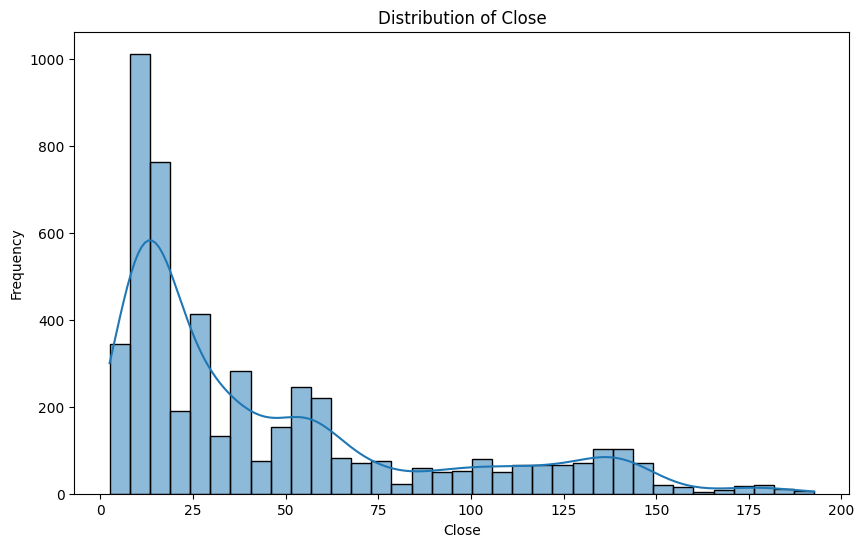

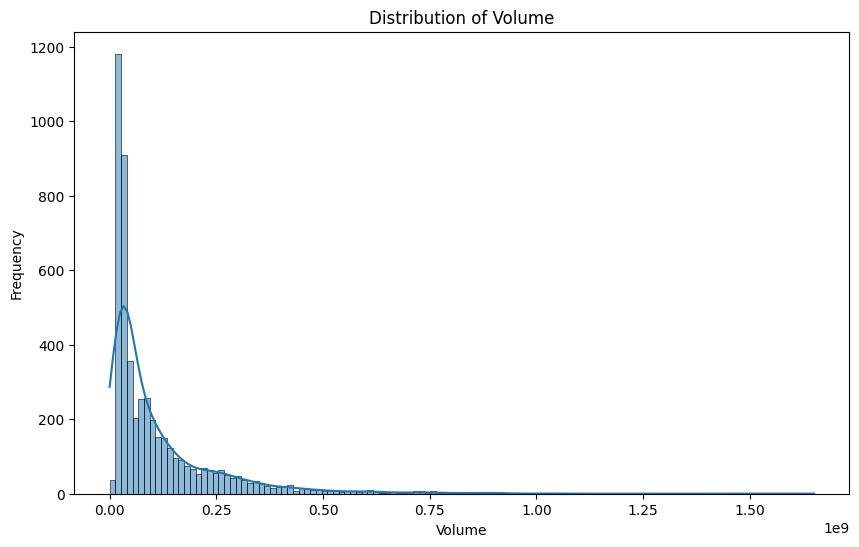

In [30]:
# Plot distributions
plot_distributions(df)

c:\Users\Darkles\10academy\10Academy-Kifiya-Week-1\env\Lib\site-packages\pyfolio\plotting.py:670: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.856%' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



Start date,2004-08-19
End date,2024-07-30
Total months,239
,Backtest
Annual return,0.856%
Cumulative returns,18.51%
Annual volatility,12.189%
Sharpe ratio,0.13
Calmar ratio,0.01
Stability,0.52
Max drawdown,-59.136%


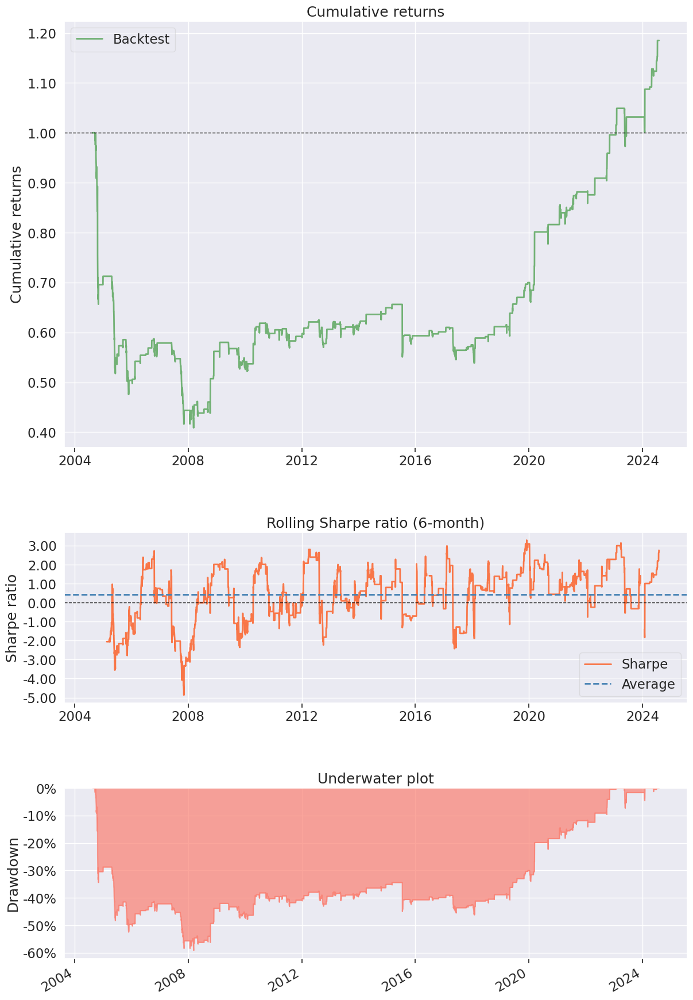

In [31]:
df['Signal'] = generate_signals(df)
df['Daily_Return'] = calculate_daily_return(df)
df['Strategy_Return'] = calculate_strategy_return(df)

create_performance_tear_sheet(df['Strategy_Return'])

In [32]:
# Calculate correlations
correlations = calculate_correlations(df, method="pearson")
correlations

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist,Signal,Daily_Return,Strategy_Return
Date,1.000000,0.880129,0.880232,0.880160,0.880252,0.880217,-0.679751,0.024127,0.019353,0.881514,...,0.881514,0.880873,0.816715,-0.290181,0.009931,-0.044091,-0.004011,0.082660,-0.013377,0.043817
Open,0.880129,1.000000,0.999915,0.999906,0.999798,0.999798,-0.465812,0.042736,0.021248,0.998472,...,0.998472,0.997788,0.920454,-0.215478,0.044044,0.002475,-0.002843,0.042146,-0.007555,0.031265
High,0.880232,0.999915,1.000000,0.999893,0.999905,0.999905,-0.465038,0.042765,0.021277,0.998517,...,0.998517,0.997736,0.922172,-0.215177,0.044581,0.003056,-0.002196,0.041999,-0.002850,0.030885
Low,0.880160,0.999906,0.999893,1.000000,0.999916,0.999916,-0.466803,0.042622,0.020240,0.998289,...,0.998289,0.997688,0.918751,-0.216029,0.047553,0.005353,-0.000313,0.040472,-0.002185,0.030023
Close,0.880252,0.999798,0.999905,0.999916,1.000000,1.000000,-0.466021,0.042748,0.020057,0.998328,...,0.998328,0.997633,0.920357,-0.215690,0.047397,0.005639,-0.000191,0.040381,0.002955,0.030041
Adj Close,0.880217,0.999798,0.999905,0.999916,1.000000,1.000000,-0.465994,0.042809,0.020054,0.998328,...,0.998328,0.997636,0.920333,-0.215677,0.047398,0.005635,-0.000233,0.040378,0.002952,0.030044
Volume,-0.679751,-0.465812,-0.465038,-0.466803,-0.466021,-0.465994,1.000000,-0.009295,-0.009119,-0.466105,...,-0.466105,-0.469317,-0.384075,0.312638,0.000552,0.062909,-0.007343,-0.084377,0.035929,-0.075372
Dividends,0.024127,0.042736,0.042765,0.042622,0.042748,0.042809,-0.009295,1.000000,-0.000228,0.043024,...,0.043024,0.044833,0.029167,-0.009924,0.000414,-0.002022,-0.025603,0.003813,0.002073,-0.000117
Stock Splits,0.019353,0.021248,0.021277,0.020240,0.020057,0.020054,-0.009119,-0.000228,1.000000,0.021551,...,0.021551,0.021417,0.036499,-0.020405,-0.011796,-0.002000,-0.013033,0.004359,-0.020682,-0.000133
SMA,0.881514,0.998472,0.998517,0.998289,0.998328,0.998328,-0.466105,0.043024,0.021551,1.000000,...,1.000000,0.999258,0.925258,-0.217051,0.010435,-0.029649,-0.049468,0.059583,-0.011574,0.034110


In [33]:
# Detect outliers
outliers = detect_outliers(df, column="Close", method="iqr")
outliers

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist,Signal,Daily_Return,Strategy_Return
Date,,,,,,,,,,,,,,,,,,,,,
2021-07-14,2021-07-14,131.901505,132.996002,131.897995,132.082504,131.932373,17912000,0.0,0.0,127.865525,...,127.865525,123.864951,1.595233,26.541766,170.103956,4.811994,0.154910,-1,0.008306,-0.008306
2021-07-15,2021-07-15,132.500000,132.595001,130.598007,131.266495,131.117294,16586000,0.0,0.0,128.144025,...,128.144025,124.012835,1.623930,26.440509,120.722614,4.748390,0.117528,0,-0.006178,0.006178
2021-07-16,2021-07-16,131.641006,132.182999,130.821503,131.845505,131.695648,14856000,0.0,0.0,128.417750,...,128.417750,124.072810,1.605185,26.346485,109.412817,4.334154,0.105598,-1,0.004411,0.000000
2021-07-21,2021-07-21,130.787003,132.617249,130.601501,132.600494,132.449768,14742000,0.0,0.0,129.114450,...,129.114450,124.730522,1.819523,22.887206,101.932942,1.939609,-0.043380,0,0.011434,0.000000
2021-07-22,2021-07-22,132.649994,133.504501,132.399994,133.328506,133.176956,13608000,0.0,0.0,129.457800,...,129.457800,124.887101,1.768450,22.649148,129.185223,3.213811,0.030005,0,0.005490,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,175.389999,177.949997,173.570007,174.369995,174.369995,31250700,0.0,0.0,185.500001,...,185.500001,176.742062,4.024337,22.104702,-219.030910,-9.493412,-1.605182,0,-0.050272,-0.000000
2024-07-25,2024-07-25,174.250000,175.199997,169.050003,169.160004,169.160004,28967900,0.0,0.0,184.689501,...,184.689501,173.399259,4.176170,23.381824,-236.032667,-9.684997,-2.142167,0,-0.029879,-0.000000
2024-07-26,2024-07-26,168.770004,169.839996,165.865005,168.679993,168.679993,25150100,0.0,0.0,183.780501,...,183.780501,170.571296,4.161800,24.967859,-225.089374,-9.690548,-2.406517,0,-0.002838,-0.000000


In [34]:
# Time-based aggregation
time_based_aggregation(df, time_column="Date", agg_column="Close", freq="ME", agg_func="mean")

,Date,Close
0,2004-08-31,2.621729
1,2004-09-30,2.820108
2,2004-10-31,3.816469
3,2004-11-30,4.420811
4,2004-12-31,4.527281
...,...,...
235,2024-03-31,143.481499
236,2024-04-30,158.730909
237,2024-05-31,173.573636
238,2024-06-30,179.243684
